In [8]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
import glob
from os.path import join, basename
from skimage.util import img_as_ubyte
import skimage as ski
from skimage import filters
from skimage import exposure

In [9]:
# Your file paths
DATAROOT = r"E:\Documentos\01_DTU\DTU-TFM\Fotos\DOE\1\1 cropped"

image_files = sorted(glob.glob(join(DATAROOT, '*.jpg')), key=lambda x: int(basename(x).split('.')[0]))


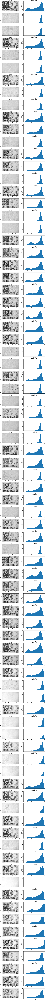

In [10]:
fig, axs = plt.subplots(len(image_files), 2, figsize=(15, 4 * len(image_files)))

# Create a CLAHE object
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))

# Calculate the histograms and contrast metric, and populate the subplots
for i in range(len(image_files)):
    img = cv2.imread(image_files[i], 0)

    # Apply CLAHE to the image
    img_clahe = clahe.apply(img)

    # Display the image
    axs[i, 0].imshow(img_clahe, cmap='gray', vmin=0, vmax=255)
    axs[i, 0].set_title(f'{basename(image_files[i])} - CLAHE')

    # Display the histogram for the CLAHE-enhanced image
    axs[i, 1].hist(img_clahe.ravel(), 256, [0, 256])
    axs[i, 1].set_title(f'Histogram {i+1} - CLAHE')
    axs[i, 1].set_xlabel('Intensity Value')
    axs[i, 1].set_ylabel('Count')
    axs[i, 1].set_xlim([0, 256])

plt.tight_layout()
plt.show()

In a histogram, the y-axis typically represents the frequency or count of pixels with a particular intensity value. Each bin on the x-axis corresponds to a range of intensity values, and the height of the bin on the y-axis represents the number of pixels in the image that have intensity values falling within that range.

In the context of image histograms:

X-axis: Represents the range of pixel intensity values (e.g., from 0 to 255 for an 8-bit grayscale image).

Y-axis: Represents the frequency or count of pixels with a particular intensity value or within a range of intensity values.

So, the higher the bar in a specific bin on the histogram, the more pixels in the image have intensity values within the corresponding range. This information can provide insights into the distribution of pixel intensities in the image, helping to analyze aspects such as contrast, brightness, and overall image characteristics.

In [11]:
fig, axs = plt.subplots(len(image_files), 2, figsize=(15, 4 * len(image_files)))
# Calculate the histograms and contrast metric, and populate the subplots
for i in range(len(image_files)):
    img = cv2.imread(image_files[i], 0)
    
    selection = img.copy()
    hist = cv2.calcHist([img], [0], None, [256], [0, 256])



    # Display the image
    axs[i, 0].imshow(selection, cmap='gray', vmin=0, vmax=255)
    axs[i, 0].set_title(f'{basename(image_files[i])}')

    # Display the histogram
    axs[i, 1].hist(img.ravel(), 256, [0, 256])
    axs[i, 1].set_title(f'Histogram {i+1}\nContrast: {np.sum(img<10)}')
    axs[i, 1].set_xlabel('Intensity Value')
    axs[i, 1].set_ylabel('Count')
    axs[i, 1].set_xlim([0, 256])

plt.tight_layout()
plt.show()

KeyboardInterrupt: 

'Contrast: {np.max(img) - np.min(img)}': This part calculates the contrast of the image. The contrast is determined by the range of pixel intensities. np.max(img) - np.min(img) calculates this range. A higher contrast value indicates a broader range of pixel intensities in the image.

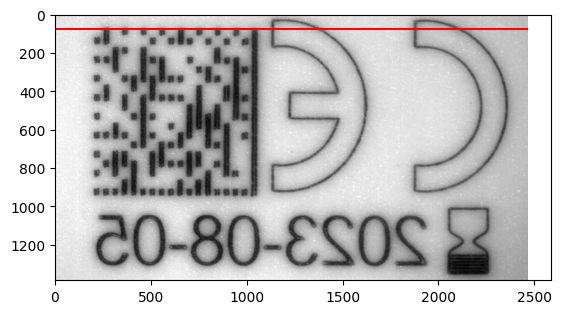

In [ ]:
# define the pixels for which we want to view the intensity (profile)
#
xmin, xmax = (0, img.shape[1])
ymin = ymax = 75

# view the image indicating the profile pixels position
#
fig, ax = plt.subplots()
ax.imshow(img, cmap='gray')
ax.plot([xmin, xmax], [ymin, ymax], color='red')

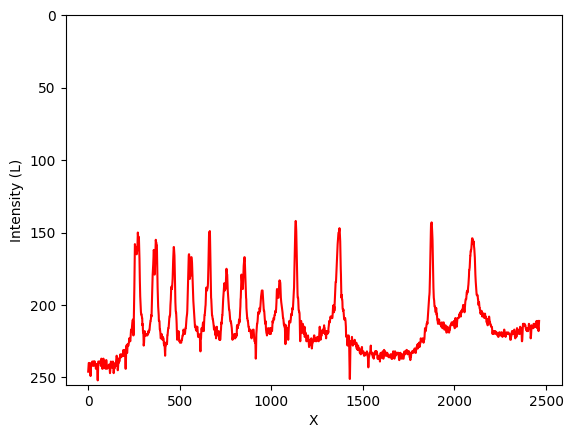

In [ ]:
# Assuming 'img' is your image and 'ymin' and 'ymax' are defined
Y = ymin = ymax

# Select the vector of pixels along the y-axis
image_gray_pixels_slice = img[Y, :]

# Ensure intensity values are in the [0, 255] range
image_gray_pixels_slice = np.clip(image_gray_pixels_slice, 0, 255)

# Plot the intensity values
fig, ax = plt.subplots()
ax.plot(image_gray_pixels_slice, color='red')
ax.set_ylim(255, 0)
ax.set_ylabel('Intensity (L)')
ax.set_xlabel('X')

plt.show()

Text(0.5, 0, 'L')

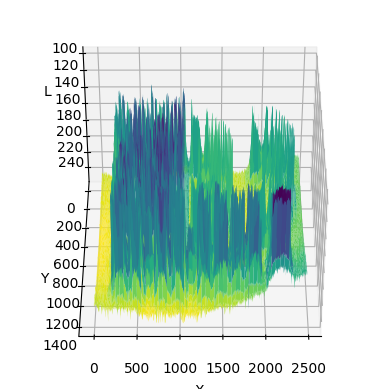

In [ ]:
from skimage.util import img_as_ubyte

size = min(img.shape)
x = np.arange(0, img.shape[1])
y = np.arange(0, img.shape[0])
X, Y = np.meshgrid(x, y)
img = img_as_ubyte(img)

fig = plt.figure()
ax = fig.add_subplot(projection='3d')
surf = ax.plot_surface(X,Y,img, cmap='viridis')

ax.view_init(elev=220, azim=-90)

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('L')